## Imports

In [1]:
import QuantumToolbox as qt
using Logging
import CairoMakie as cm
using DifferentialEquations
using MiniLoggers
using ProgressMeter
using LoggingExtras
using Revise
using Dates
using YAXArrays

using LinearAlgebra
import LsqFit as LF

using Zygote

using JSON3

In [2]:
import SuperconductingCavities as SC

## Logger Setups

In [3]:
# MiniLogger(minlevel = MiniLoggers.Info) |> global_logger
InfoLogger = MiniLogger(minlevel = MiniLoggers.Info)
ProgressLogger = MiniLogger(minlevel = LogLevel(-1))
DebugLogger = MiniLogger(minlevel = MiniLoggers.Debug)

global_logger(InfoLogger)

Base.CoreLogging.SimpleLogger(VSCodeServer.IJuliaCore.IJuliaStdio{Base.PipeEndpoint, typeof(VSCodeServer.io_send_callback)}(IOContext(Base.PipeEndpoint(RawFD(21) open, 0 bytes waiting)), VSCodeServer.io_send_callback), Info, Dict{Any, Int64}())

# Random Experimentations

In [290]:
pt = 10
rt = 2
func(u, p, t) = SC.Dynamics.Envelopes.Sine_Squared_Ramp_Envelope(t[1], pulse_time = pt, ramp_time = rt)

u0 = 0
tspan = [0, pt]

prob = ODEProblem(func, u0, tspan)

sol = solve(prob, reltol = 1e-9);


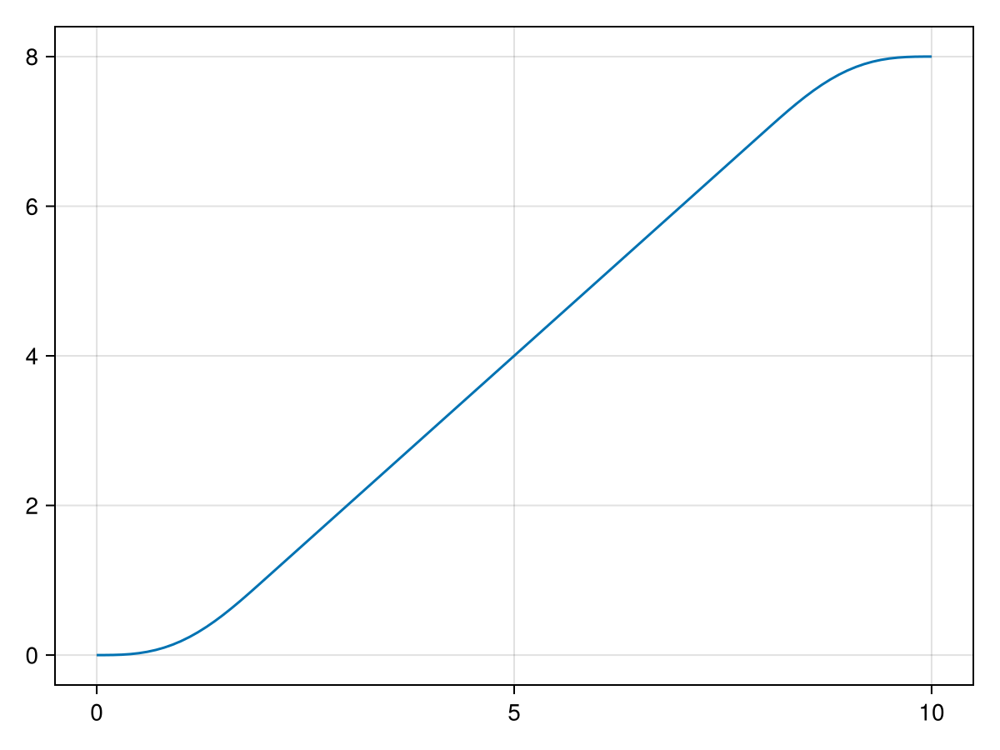

In [5]:
f = cm.Figure()
ax = cm.Axis(f[1,1])

times = collect(LinRange(0, pt, 100))
y = sol.(times)
cm.lines!(ax, times, y)
f

# Mode 3

In [4]:
Mode3 = SC.Circuits.Transmon_Resonators.load("ModelSaves/Mode3/Mode3.json");

In [5]:
Mode3.params

Dict{Any, Any} with 15 entries:
  "Nrs"          => Any[10]
  "E_C"          => 0.102833
  "Cavity_Names" => Any["Mode 3"]
  "E_J"          => 26.9698
  "Nt_cut"       => 60
  "E_oscs"       => 6.22809
  "Nt"           => 10
  "ModelType"    => "TransmonResonators"
  "ng"           => 0
  "kappa_tc"     => 1.78571e-5
  "kappa_td"     => 1.2348e-5
  "kappa_cc"     => 1.0e-6
  "Model_Name"   => "Mode3"
  "gs"           => 0.0261844
  "Save_Path"    => "ModelSaves/Mode3/"

### Calibrating no ramp

In [25]:
state1 = (2,0)
state2 = (0,1)

ψ1 = Mode3.dressed_states[state1]
ψ2 = Mode3.dressed_states[state2]

ν = Mode3.Stuff["op_drive_params"]["sb_f0g1"]["freq_d"]
stark_shift = Mode3.Stuff["op_drive_params"]["sb_f0g1"]["shift"]

ε = 0.78

t_range = [150, 200]
envelope = "Square"
envelope_args = Dict{Any, Any}()


SC.Dynamics.OptimizePulse(Mode3, ψ1, ψ2, ε, freq_d, stark_shift, t_range, envelope, envelope_args, levels = 5, samples_per_level = 50)

UndefVarError: UndefVarError: `Mode3` not defined

## Error Budget Plot (Bare Loss Ops)

### Loading Data

In [6]:
push!(collect(keys(Mode3.CandD_Ops)), "Bare Mode 3 Collapse_Bare Transmon Collapse_Bare Transmon Dephasing")

4-element Vector{Any}:
 "Bare Transmon Collapse"
 "Bare Mode 3 Collapse"
 "Bare Transmon Dephasing"
 "Bare Mode 3 Collapse_Bare Transmon Collapse_Bare Transmon Dephasing"

In [7]:
init_states = ["g0", "e0", "g0_p_e0", "g0_m_e0", "g0_p_ie0", "g0_m_ie0"]
losses = push!(collect(keys(Mode3.CandD_Ops)), "Bare Mode 3 Collapse_Bare Transmon Collapse_Bare Transmon Dephasing")
losses = push!(losses, "")

itert = Iterators.product(init_states, losses)

Mode3ErrorBudgetBare = Dict{Any, Any}()

order = ["Step_1", "Step_2", "Step_3", "Step_4", "Step_5", "Step_6", "Step_7", "Step_8", "Step_9", "Step_10", "Step_11", "Step_12", "Step_13", "Step_14", "Step_15", "Step_16", "Step_17", "Step_18"]

the_path = "Data/Binomial_Encoding_Sun-Oct-13-24:18:2/data/"

for combo in itert
    file_name = the_path*combo[1]*"_"*combo[2]*".nc"
    if combo[2] == ""
        file_name = the_path*combo[1]*".nc"
    end
    @info file_name
    Mode3ErrorBudgetBare[combo] = SC.Utils.LoadRunResults(file_name, cube_order = order, h_dims = [10,10])
end


┌ Info: Data/Binomial_Encoding_Sun-Oct-13-24:18:2/data/g0_Bare Transmon Collapse.nc
└ @ Main /local/gr400/Git Repositories/CavityModeDriveSimulations/UsingJuliaBase/RunsForPaper/jl_notebook_cell_df34fa98e69747e1a8f8a730347b8e2f_X16sZmlsZQ==.jl:18
Progress: 100%|█████████████████████████████████████████| Time: 0:00:08
┌ Info: Data/Binomial_Encoding_Sun-Oct-13-24:18:2/data/e0_Bare Transmon Collapse.nc
└ @ Main /local/gr400/Git Repositories/CavityModeDriveSimulations/UsingJuliaBase/RunsForPaper/jl_notebook_cell_df34fa98e69747e1a8f8a730347b8e2f_X16sZmlsZQ==.jl:18
Progress: 100%|█████████████████████████████████████████| Time: 0:00:03
┌ Info: Data/Binomial_Encoding_Sun-Oct-13-24:18:2/data/g0_p_e0_Bare Transmon Collapse.nc
└ @ Main /local/gr400/Git Repositories/CavityModeDriveSimulations/UsingJuliaBase/RunsForPaper/jl_notebook_cell_df34fa98e69747e1a8f8a730347b8e2f_X16sZmlsZQ==.jl:18
Progress:  10%|████                                     |  ETA: 0:00:05

InterruptException: InterruptException:

In [8]:
state_dict = Dict{Any, Any}()
for state in collect(Iterators.product([0,1,2], [0,1,2,3,4]))
    state_dict[state] = Mode3.dressed_states[state]
end

Projection_Ops = SC.Utils.Get_Projection_Ops(state_dict)

Probabilities = Dict{Any, Any}()
for key in keys(Mode3ErrorBudgetBare)
    @info "On $key"
    Probabilities[key] = SC.Utils.Get_EVs(Mode3ErrorBudgetBare[key]["states"], Projection_Ops)
end

┌ Info: On ("g0", "Bare Transmon Collapse")
└ @ Main /local/gr400/Git Repositories/CavityModeDriveSimulations/UsingJuliaBase/RunsForPaper/jl_notebook_cell_df34fa98e69747e1a8f8a730347b8e2f_X20sZmlsZQ==.jl:10
┌ Info: On ("e0", "Bare Transmon Collapse")
└ @ Main /local/gr400/Git Repositories/CavityModeDriveSimulations/UsingJuliaBase/RunsForPaper/jl_notebook_cell_df34fa98e69747e1a8f8a730347b8e2f_X20sZmlsZQ==.jl:10


In [9]:
Probabilities[("g0", "Bare Mode 3 Collapse_Bare Transmon Collapse_Bare Transmon Dephasing")][(0,2)][end]

KeyError: KeyError: key ("g0", "Bare Mode 3 Collapse_Bare Transmon Collapse_Bare Transmon Dephasing") not found

### Plotting All State Evolutions

[2024-10-15 20:50:28] Info: Making Plot
[2024-10-15 20:50:30] Info: Making Plot
[2024-10-15 20:50:32] Info: Making Plot
[2024-10-15 20:50:33] Info: Making Plot
[2024-10-15 20:50:35] Info: Making Plot
[2024-10-15 20:50:37] Info: Making Plot
[2024-10-15 20:50:38] Info: Making Plot
[2024-10-15 20:50:40] Info: Making Plot
[2024-10-15 20:50:42] Info: Making Plot
[2024-10-15 20:50:43] Info: Making Plot
[2024-10-15 20:50:45] Info: Making Plot
[2024-10-15 20:50:47] Info: Making Plot
[2024-10-15 20:50:48] Info: Making Plot
[2024-10-15 20:50:50] Info: Making Plot
[2024-10-15 20:50:52] Info: Making Plot
[2024-10-15 20:50:53] Info: Making Plot
[2024-10-15 20:50:55] Info: Making Plot
[2024-10-15 20:50:57] Info: Making Plot
[2024-10-15 20:50:58] Info: Making Plot
[2024-10-15 20:51:00] Info: Making Plot
[2024-10-15 20:51:02] Info: Making Plot
[2024-10-15 20:51:03] Info: Making Plot
[2024-10-15 20:51:05] Info: Making Plot
[2024-10-15 20:51:07] Info: Making Plot
[2024-10-15 20:51:08] Info: Making Plot


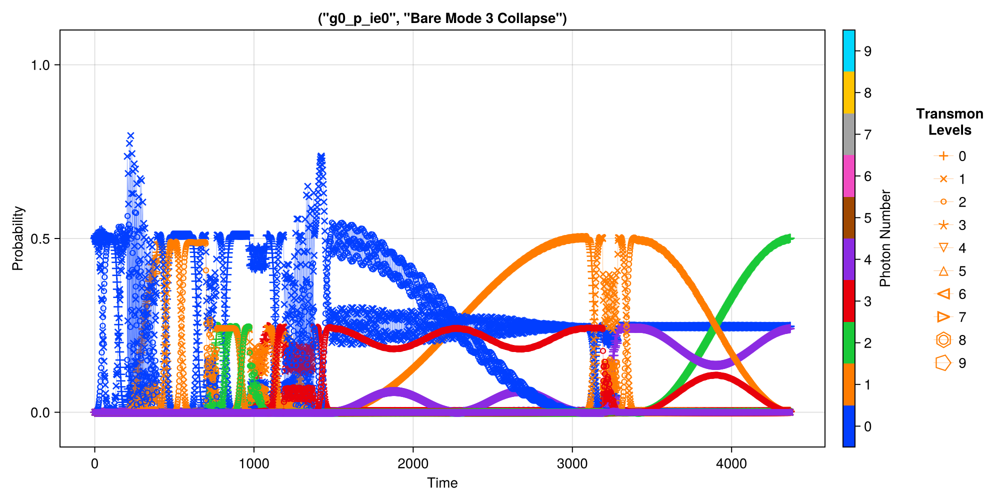

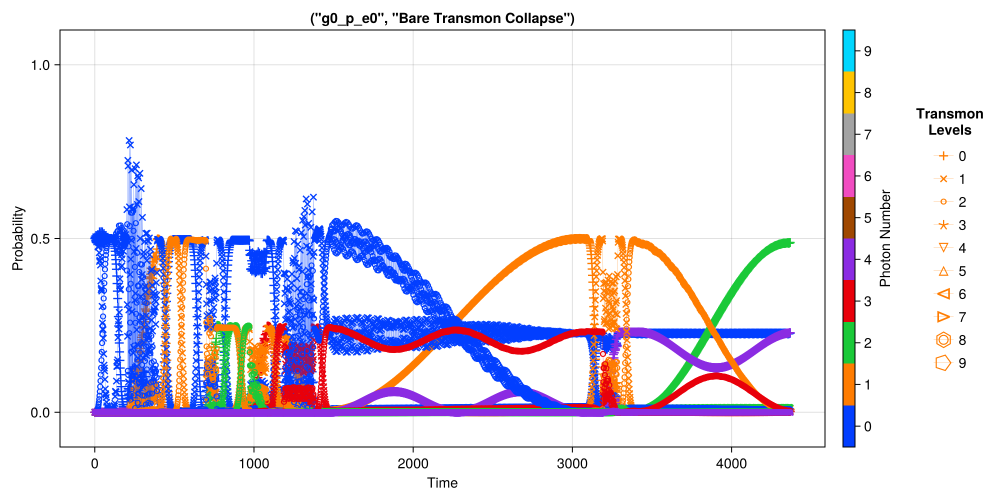

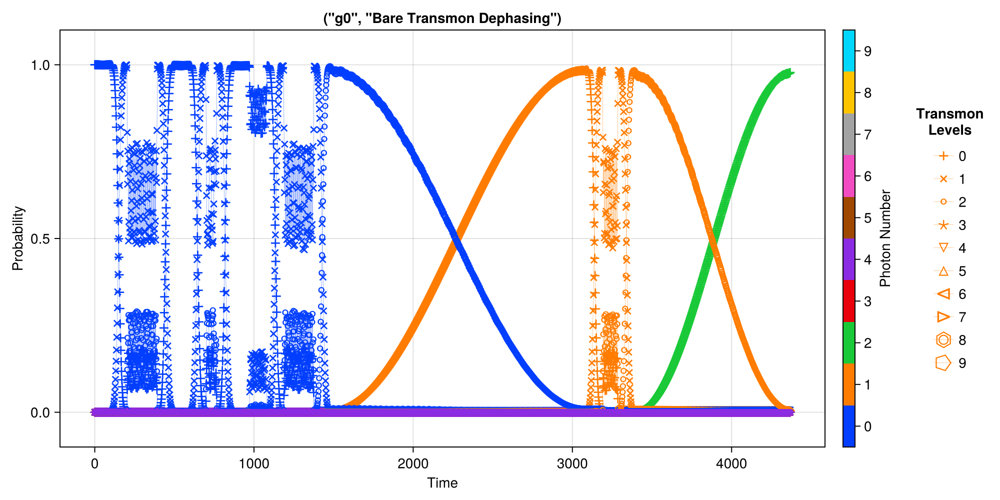

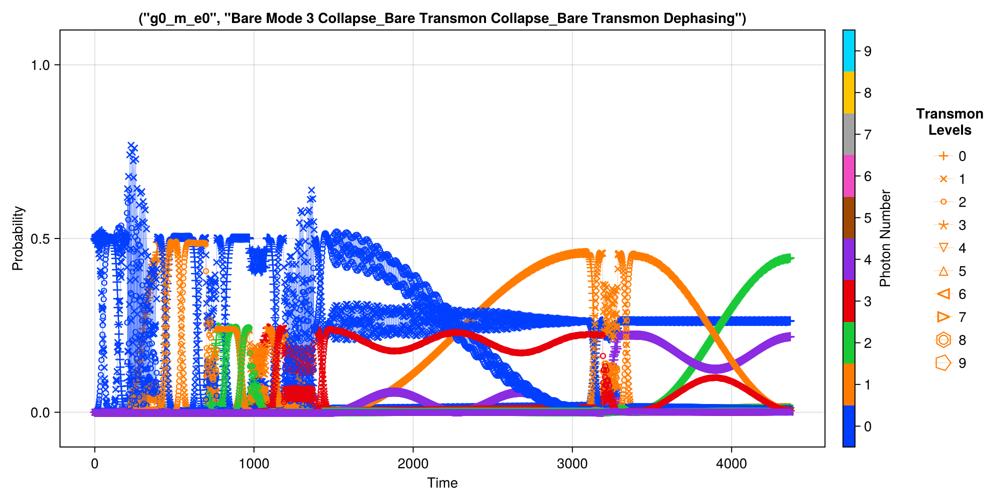

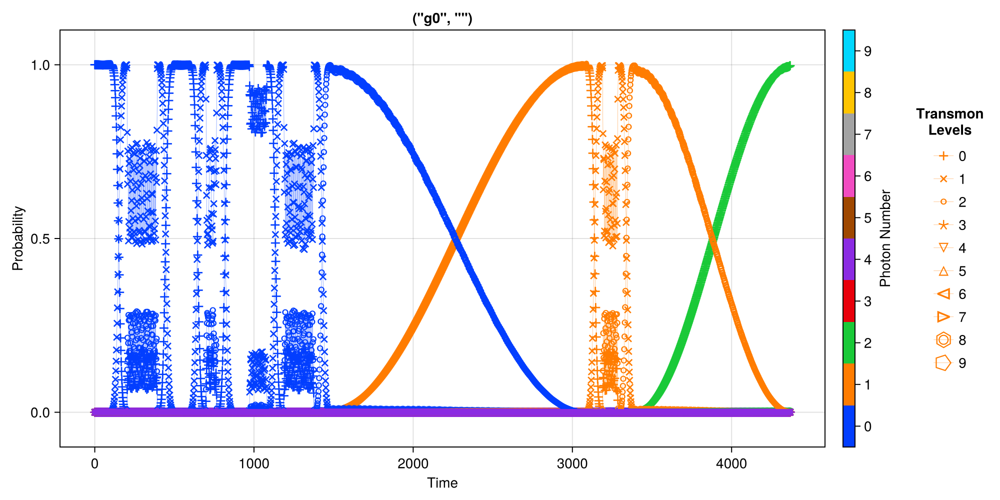

...

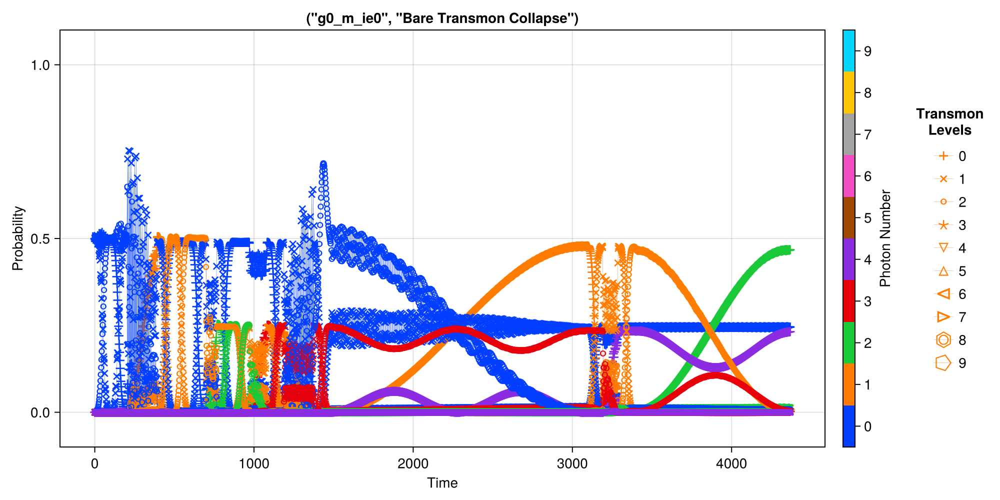

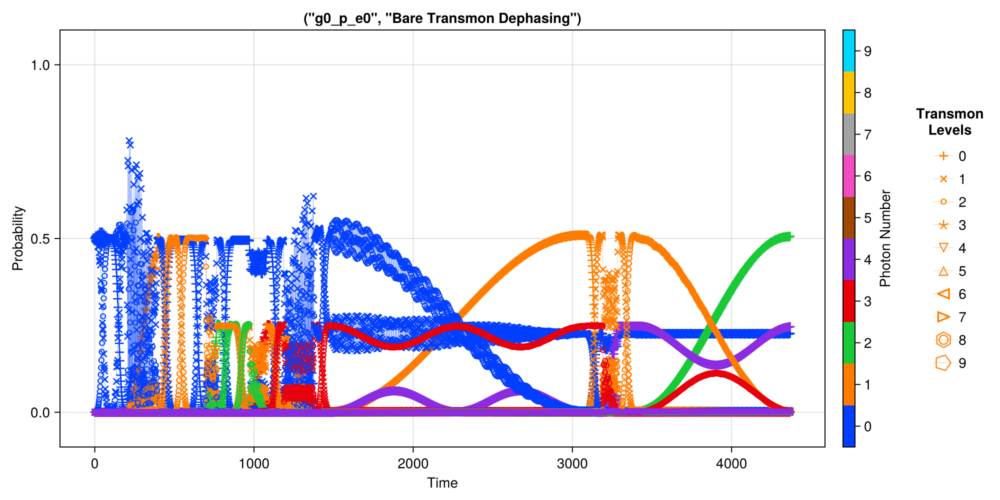

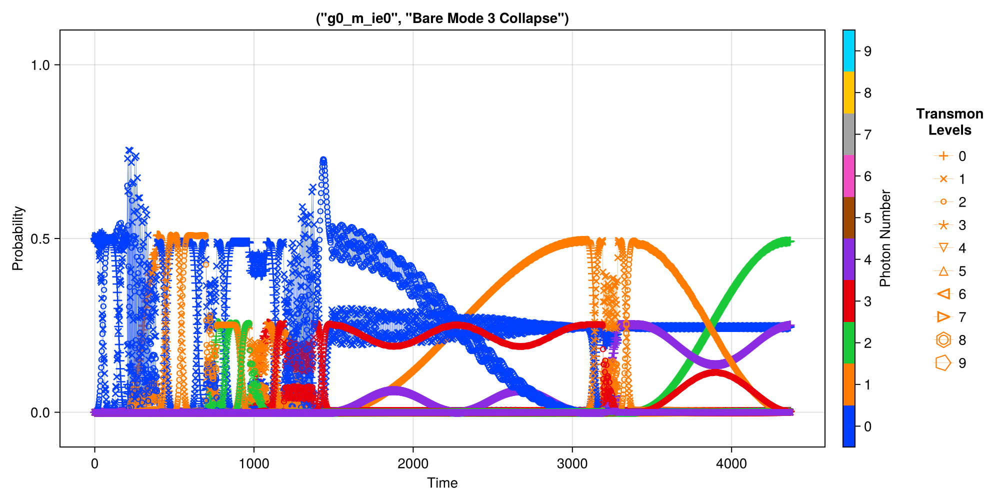

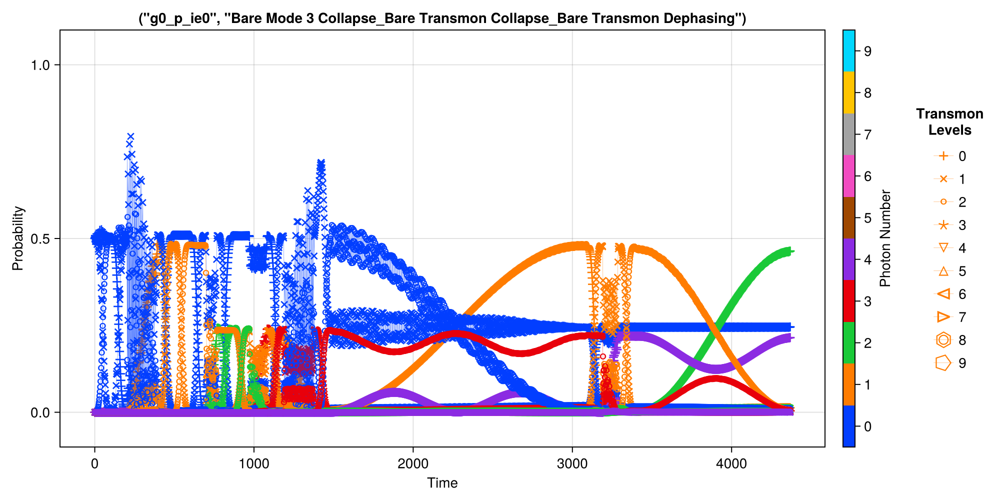

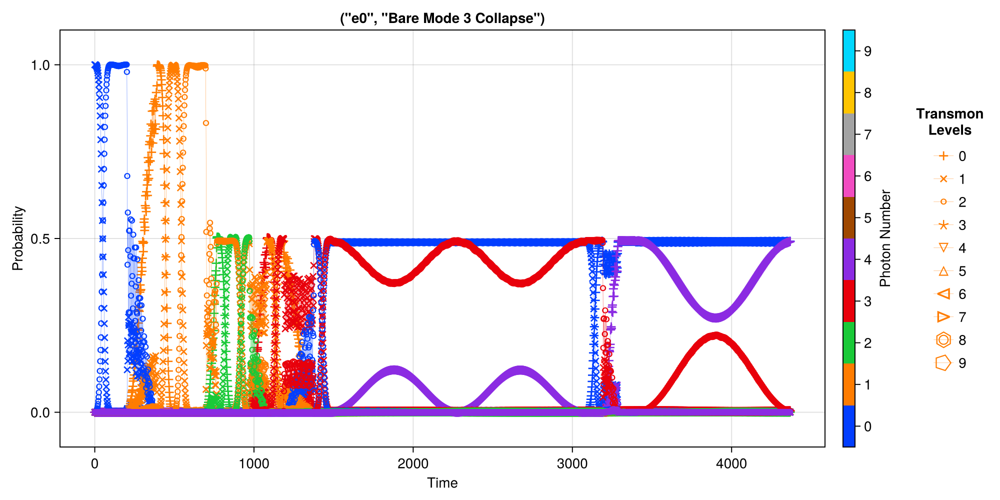

In [210]:
for key in keys(Mode3ErrorBudgetBare)
    axis_kwargs = Dict{Any, Any}("title" => string(key))
    SC.Dynamics.PlotSingleModeEvolution(Mode3, Mode3ErrorBudgetBare[key]["times"], Probabilities[key], axis_kwargs = axis_kwargs)
end

# Plots of Ramp times and shapes

In [17]:
Mode3.Stuff["op_drive_params"]#["f0g1_SS_10.0"]

Dict{String, Any} with 776 entries:
  "f0g1_G_81.77215189873418_chirped"   => Dict{String, Any}("pulse_time"=>343.5…
  "f0g1_G_2.0209999999999995_chirped"  => Dict{String, Any}("pulse_time"=>182.7…
  "f0g1_G_90.88607594936708_chirped"   => Dict{String, Any}("pulse_time"=>361.6…
  "f0g1_G_55.44303797468354"           => Dict{String, Any}("pulse_time"=>277.6…
  "f0g1_G_14.545_chirped"              => Dict{String, Any}("pulse_time"=>189.9…
  "f0g1_G_0.001"                       => Dict{String, Any}("pulse_time"=>180.0…
  "f0g1_G_92.9113924050633"            => Dict{String, Any}("pulse_time"=>344.5…
  "f0g1_SS_8.687"                      => Dict{String, Any}("pulse_time"=>196.0…
  "f0g1_G_86.83544303797468"           => Dict{String, Any}("pulse_time"=>333.6…
  "q_ge_0"                             => Dict{String, Any}("pulse_time"=>100, …
  "f0g1_G_5.253"                       => Dict{String, Any}("pulse_time"=>190.5…
  "f0g1_SS_6.061"                      => Dict{String, Any}("pulse_time"=

In [73]:
Ramp_Times = vcat(collect(LinRange(0.001, 20-0.001, 100)),collect(LinRange(20, 100, 80)))
envelopes = ["Sine_Squared_Ramp", "Gaussian_Ramp"]
chirped = [true, false]

res = Dict{Any, Any}()

for envelope in envelopes
    for rt in Ramp_Times
        for chirp in chirped
            drive_name = ""
            if envelope == "Sine_Squared_Ramp"
                drive_name = "f0g1_SS_"*string(rt)
            end
            if envelope == "Gaussian_Ramp"
                drive_name = "f0g1_G_"*string(rt)
            end

            if chirp
                drive_name = drive_name*"_chirped"
            end

            if drive_name in keys(Mode3.Stuff["op_drive_params"])
                res[drive_name] = Mode3.Stuff["op_drive_params"][drive_name]["accuracy"]
            end
        end
    end
end

In [74]:
SS = []
SS_x = []
SS_chirp = []
SS_chirp_x = []

G = []
G_x = []
G_chirp = []
G_chirp_x = []

for key in keys(res)
    key_split = split(key, "_")
    if length(key_split) == 4
        if key_split[2] == "SS"
            push!(SS_chirp, res[key])
            push!(SS_chirp_x, Meta.parse(key_split[3]))
        end
        if key_split[2] == "G"
            push!(G_chirp, res[key])
            push!(G_chirp_x, Meta.parse(key_split[3]))
        end
    else
        if key_split[2] == "SS"
            push!(SS, res[key])
            push!(SS_x, Meta.parse(key_split[3]))
        end
        if key_split[2] == "G"
            push!(G, res[key])
            push!(G_x, Meta.parse(key_split[3]))
        end
    end
end


In [75]:
permvec = sortperm(SS_x)
SS = SS[permvec]
SS_x = sort(SS_x)

permvec = sortperm(SS_chirp_x)
SS_chirp = SS_chirp[permvec]
SS_chirp_x = sort(SS_chirp_x)

permvec = sortperm(G_x)
G = G[permvec]
G_x = sort(G_x)

permvec = sortperm(G_chirp_x)
G_chirp = G_chirp[permvec]
G_chirp_x = sort(G_chirp_x);

In [81]:
SS_chirp_x[argmax(SS_chirp)]

70.63291139240506

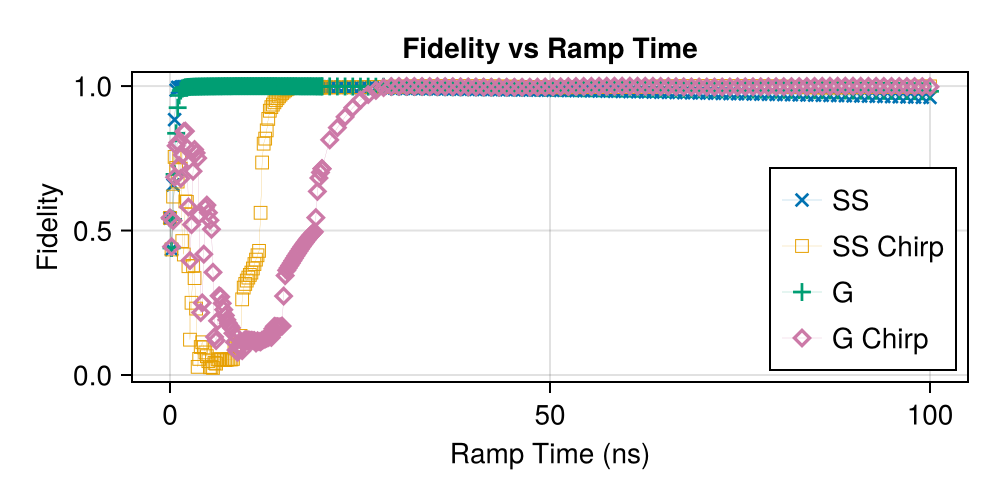

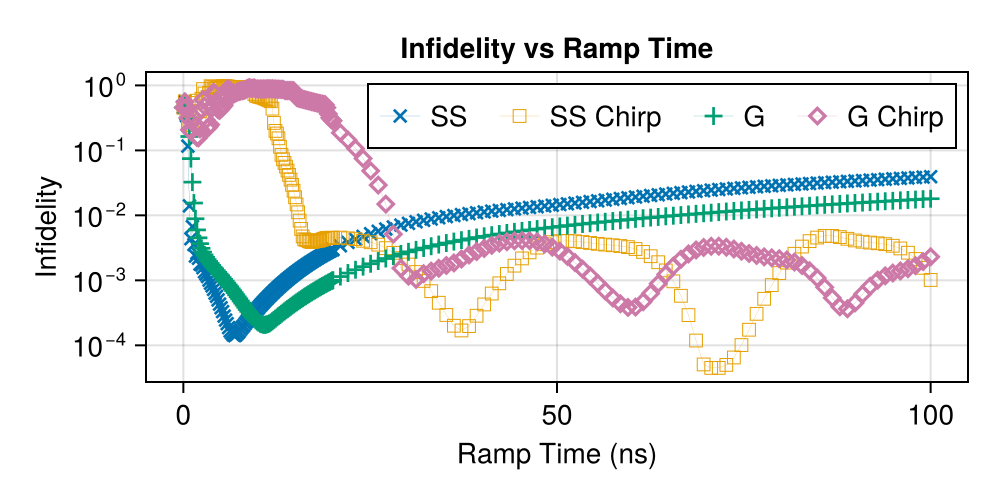

CairoMakie.Screen{IMAGE}


In [21]:
f = cm.Figure(size = (500, 250), px_per_unit = 8)
ax = cm.Axis(f[1,1], title = "Fidelity vs Ramp Time", xlabel = "Ramp Time (ns)", ylabel = "Fidelity")

cm.scatterlines!(ax, SS_x, SS, marker = '×', label = "SS", linewidth = 0.1, markersize = 20)
cm.scatterlines!(ax, SS_chirp_x, SS_chirp, marker = '□', label = "SS Chirp", linewidth = 0.1)
cm.scatterlines!(ax, G_x, G, marker = '+', label = "G", linewidth = 0.1, markersize = 20)
cm.scatterlines!(ax, G_chirp_x, G_chirp, marker = '⋄', markersize = 20, label = "G Chirp", linewidth = 0.1)
cm.axislegend(ax, position = :rb)

cm.display(f)


 
f = cm.Figure(size = (500, 250), px_per_unit = 8)
ax = cm.Axis(f[1,1], yscale = cm.log10, title = "Infidelity vs Ramp Time", xlabel = "Ramp Time (ns)", ylabel = "Infidelity")

cm.scatterlines!(ax, SS_x, -(SS.-1), marker = '×', label = "SS", linewidth = 0.1, markersize = 20)
cm.scatterlines!(ax, SS_chirp_x, -(SS_chirp.-1), marker = '□', label = "SS Chirp", linewidth = 0.1)
cm.scatterlines!(ax, G_x, -(G.-1), marker = '+', label = "G", linewidth = 0.1, markersize = 20)
cm.scatterlines!(ax, G_chirp_x, -(G_chirp.-1), marker = '⋄', markersize = 20, label = "G Chirp", linewidth = 0.1)
cm.axislegend(ax, position = :rt, orientation = :horizontal)

cm.display(f)




# Ramp Time Floquet

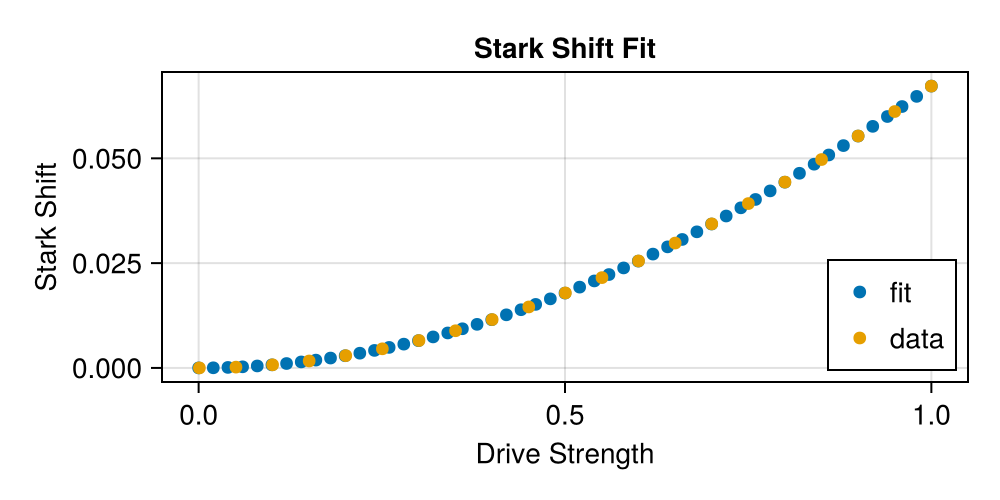

In [5]:
m(ε) = sum(Mode3.Stuff["Chirp Params"]["fn_gn+1"][1]["param"][n]*ε^n for n in 1:length(Mode3.Stuff["Chirp Params"]["fn_gn+1"][1]["param"]))
f = cm.Figure(size = (500, 250))
ax = cm.Axis(f[1,1], title = "Stark Shift Fit", xlabel = "Drive Strength", ylabel = "Stark Shift")

x = collect(LinRange(0, 1, 51))
cm.plot!(ax, x, m.(x), label = "fit")
cm.plot!(ax, Mode3.Stuff["Chirp Params"]["fn_gn+1"][2], Mode3.Stuff["Chirp Params"]["fn_gn+1"][3], label = "data")
cm.axislegend(ax, position = :rb)

f

## Chirped

In [6]:
for key in keys(Mode3.Stuff["op_drive_params"])
    println(key)
end 

f0g1_G_81.77215189873418_chirped
f0g1_G_2.0209999999999995_chirped
f0g1_G_90.88607594936708_chirped
f0g1_G_55.44303797468354
f0g1_G_14.545_chirped
f0g1_G_0.001
f0g1_G_92.9113924050633
f0g1_SS_8.687
f0g1_G_86.83544303797468
q_ge_0
f0g1_G_5.253
f0g1_SS_6.061
f0g1_G_32.151898734177216
f0g1_SS_43.291139240506325
f0g1_SS_7.5
f0g1_G_27.088607594936704_chirped
f0g1_G_75.69620253164558
f0g1_G_6.061_chirped
f0g1_SS_11.918999999999999_chirped
f0g1_G_24.050632911392405
f0g1_G_3.233_chirped
f0g1_SS_9.495_chirped
f0g1_SS_10.101_chirped
f0g1_G_85.82278481012659_chirped
f0g1_G_56.45569620253165
f0g1_G_0.405
f0g1_G_62.531645569620245_chirped
f0g1_SS_38.22784810126582_chirped
f0g1_G_78.73417721518987_chirped
f0g1_SS_12.121
f0g1_G_9.495
f0g1_G_73.67088607594937_chirped
f0g1_G_70.63291139240506
f0g1_SS_14.140999999999998
f0g1_SS_60.0_chirped
f0g1_G_16.767_chirped
f0g1_G_2.5
f0g1_SS_18.989_chirped
f0g1_SS_17.171
f0g1_SS_54.43037974683544
f0g1_G_8.283_chirped
f0g1_G_60.50632911392405
f0g1_G_15.0
f0g1_G_13.

In [297]:
op_name = "f0g1_SS_5.0_chirped" #"f0g1_SS_70.63291139240506_chirped"
pulse = copy(Mode3.Stuff["op_drive_params"][op_name])

#pulse["pulse_time"] = 50
envelope_args = Dict{Symbol, Any}()
for key in keys(Mode3.Stuff["op_drive_params"][op_name]["Envelope Args"])
    envelope_args[Symbol(key)] = Mode3.Stuff["op_drive_params"][op_name]["Envelope Args"][key]
end

pt = pulse["pulse_time"]
rt = pulse["Envelope Args"]["ramp_time"]
ft = pt-2*rt 


ε0 = pulse["epsilon"]
ν0 = pulse["freq_d"]


εt(t) = ε0*SC.Dynamics.Envelopes.Envelope_Dict[pulse["Envelope"]](t; envelope_args...)


νε(ε) = SC.Dynamics.chirper(ν0, pulse["chirp_params"])(ε)#ν0+ pulse["shift"] #sum(pulse["chirp_params"][n]*ε^n for n in 1:length(pulse["chirp_params"]))
#νε(ε) = ν0+pulse["shift"]

νft = νε(ε0) 
Tft = abs(1/νft)
T0 = abs(1/ν0)

Tr =1*Tft

#Tft = 11.933186243883748
times = sort(vcat(collect(0:Tr:floor(rt/Tr)*Tr), collect(rt+0.05*Tft:Tft:floor((ft+rt)/Tft)*Tft), collect(ceil((ft+rt)/Tr)*Tr:Tr:pt), [pt]))
#times = sort(vcat(collect(0:Tr:floor(rt/Tr)*Tr), collect(rt:10*Tft:floor((ft+rt)/Tft)*Tft), collect(ceil((ft+rt)/Tr)*Tr:Tr:pt), [pt]))

#times = vcat([0], [26.82789316143208, 38.84818295454126, 50.52005855074872, 62.5403483438579, 74.21222394006536, 86.23251373317454, 98.25280352628373, 109.92467912249118, 121.94496891560037, 133.96525870870954, 145.637134304917, 157.65742409802618, 170.02612808803707], [pt])#vcat([0], collect(26.82789316143208:Tft:pt), [pt])

#times = vcat(collect(0:0.36:pt), [pt])
Tr = 0.3503
#times = vcat(collect(0:Tr:rt), collect(floor(rt/Tr)*Tr:Tft:ft+rt), collect(floor((ft+rt)/Tft)*Tft:Tr:pt), [pt])
times = vcat(collect(0:Tr:rt), collect(floor(rt/Tr)*Tr:Tft:pt))#
ψ = Mode3.dressed_states[(2,0)]

solver_kwargs = Dict{Any, Any}("abstol" => 1e-8, "reltol" => 1e-8)
pulse_res = SC.Dynamics.RunSingleOperator(Mode3, ψ, pulse, spns = 10, solver_kwargs = solver_kwargs, tspan = times)



Solution of time evolution
(return code: Success)
--------------------------
num_states = 539
num_expect = 0
ODE alg.: Vern9{typeof(OrdinaryDiffEqCore.trivial_limiter!), typeof(OrdinaryDiffEqCore.trivial_limiter!), Static.False}(OrdinaryDiffEqCore.trivial_limiter!, OrdinaryDiffEqCore.trivial_limiter!, static(false), true)
abstol = 1.0e-8
reltol = 1.0e-8


In [298]:
times[10:20]

11-element Vector{Float64}:
 3.1527
 3.503
 3.8533
 4.2036
 4.5539
 4.9042
 4.9042
 5.2578170982958685
 5.611434196591738
 5.965051294887606
 6.318668393183474

In [299]:
4.9042

4.9042

In [300]:
# f = cm.Figure(size = (1000, 500))
# ax = cm.Axis(f[1,1])

# times = collect(LinRange(0, pt, 1000))
# y = []
# for t in times
#     push!(y, sin.(pulse_res(t)))
# end

# y2 = []
# for t in times
#     push!(y2, sin.(2*π*(ν0+pulse["shift"])*t))
# end

# cm.lines!(ax, times, y, label = "using ϕ")
# cm.lines!(ax, times, y2, label = "using normal")
# cm.axislegend(ax, position = :rt)
# f

In [301]:
states_to_track = Dict{Any, Any}();
states_to_track[(0,0)] = Mode3.dressed_states[(0,0)];
states_to_track[(1,0)] = Mode3.dressed_states[(1,0)];
states_to_track[(2,0)] = Mode3.dressed_states[(2,0)];
states_to_track[(3,0)] = Mode3.dressed_states[(3,0)];
#states_to_track[(4,0)] = Mode3.dressed_states[(4,0)];
states_to_track[(0,1)] = Mode3.dressed_states[(0,1)];
states_to_track[(1,1)] = Mode3.dressed_states[(1,1)];
#states_to_track[(2,1)] = Mode3.dressed_states[(2,1)];
#states_to_track[(3,1)] = Mode3.dressed_states[(3,1)];
#states_to_track[(0,2)] = Mode3.dressed_states[(0,2)];
#states_to_track[(1,2)] = Mode3.dressed_states[(1,2)];
#states_to_track[(2,2)] = Mode3.dressed_states[(2,2)];
#states_to_track = copy(Mode3.dressed_states)#Dict{Any, Any}();

Quantum Object:   type=Ket   dims=[10, 10]   size=(100,)
100-element Vector{ComplexF64}:
   -0.004038192027169059 + 0.0im
  -6.969636005358362e-16 + 0.0im
     0.03811363894701519 + 0.0im
  -8.978745354959314e-19 + 0.0im
   1.8763616931126505e-6 + 0.0im
 -1.0310373427216206e-19 + 0.0im
   7.317077475578563e-11 + 0.0im
   1.883814299572505e-21 + 0.0im
  2.6091945017705704e-15 + 0.0im
  -7.626709405379582e-19 + 0.0im
                         ⋮
   5.953403200247595e-10 + 0.0im
 -1.4769367739777188e-17 + 0.0im
   4.1172648697004484e-9 + 0.0im
  1.7292805823097684e-17 + 0.0im
  1.3443118641529189e-11 + 0.0im
  1.2782950405263528e-17 + 0.0im
   9.100101460012872e-15 + 0.0im
   1.899919034515057e-17 + 0.0im
                     0.0 + 0.0im

In [302]:

#P = Progress(length(times))#length(epsilons_to_sample))

list_of_params = []

dt = pulse_res.times[2]-pulse_res.times[1]
for t in pulse_res.times
    ε = εt(t)
    ν = νε(ε)
    dict_to_append = Dict{Any, Any}("ε" => ε, "ν" => ν)#, "t" => t)
    #if t<rt
    #    dict_to_append["t"] = t
    #end
    #if t>=rt
    #    dict_to_append["t"] = t#-rt
    #end
    push!(list_of_params, dict_to_append)
end

floq_sweep_res = SC.Dynamics.Floquet_t0_Sweep(Mode3, list_of_params, states_to_track = states_to_track);

println("hi") 



In [303]:
projections = Dict{Any, Any}()


for state in keys(states_to_track)
    projections[state] = []
    for i in 1:length(pulse_res.times)
        t = pulse_res.times[i]
        ε = εt(t)
        #idx = findall(x -> x == ε, epsilons_to_sample)
        Φ = floq_sweep_res[State = At(string(state)), Step = At(i)]["ψ"]
        push!(projections[state], abs(pulse_res.states[i]'*Φ)^2)
    end
end

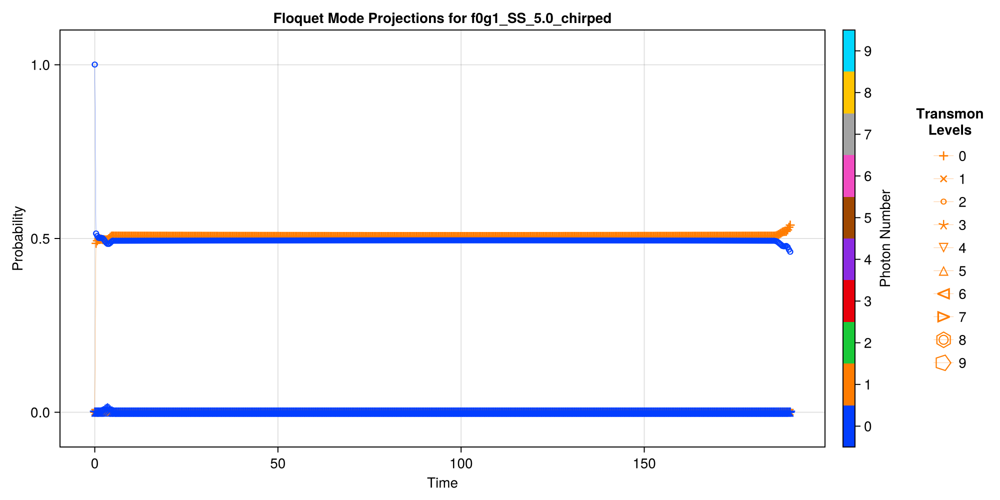

CairoMakie.Screen{IMAGE}


In [304]:
axis_kwargs = Dict{Any, Any}("title" => "Floquet Mode Projections for "*op_name)
SC.Dynamics.PlotSingleModeEvolution(Mode3, pulse_res.times, projections, axis_kwargs = axis_kwargs)

In [293]:
projections = JSON3.read("Data/Floquet_Sweep/f0g1_SS_5.0_chirped.json", Dict{Any, Any})
times = vcat(collect(0:0.01:pt), [10]);

axis_kwargs = Dict{Any, Any}("title" => "Floquet Mode Projections for "*op_name)
SC.Dynamics.PlotSingleModeEvolution(Mode3, times, projections, axis_kwargs = axis_kwargs)

DimensionMismatch: DimensionMismatch: arrays could not be broadcast to a common size; got a dimension with lengths 19002 and 1002

In [294]:
T0

0.3484141969017153

In [295]:
projections

Dict{Any, Any} with 6 entries:
  "(1, 1)" => Any[8.88468e-30, 1.99498e-25, 5.00055e-23, 1.20781e-21, 1.09881e-…
  "(1, 0)" => Any[5.05185e-32, 1.81749e-11, 2.70939e-10, 1.22012e-9, 3.28347e-9…
  "(0, 1)" => Any[9.45205e-21, 0.315441, 0.483707, 0.483234, 0.483007, 0.482914…
  "(0, 0)" => Any[1.21016e-30, 3.38497e-23, 7.48575e-21, 1.50728e-19, 1.08204e-…
  "(2, 0)" => Any[1.0, 0.684559, 0.516294, 0.516766, 0.516993, 0.517086, 0.5171…
  "(3, 0)" => Any[2.09504e-32, 3.16997e-11, 4.75411e-10, 2.16294e-9, 5.90587e-9…

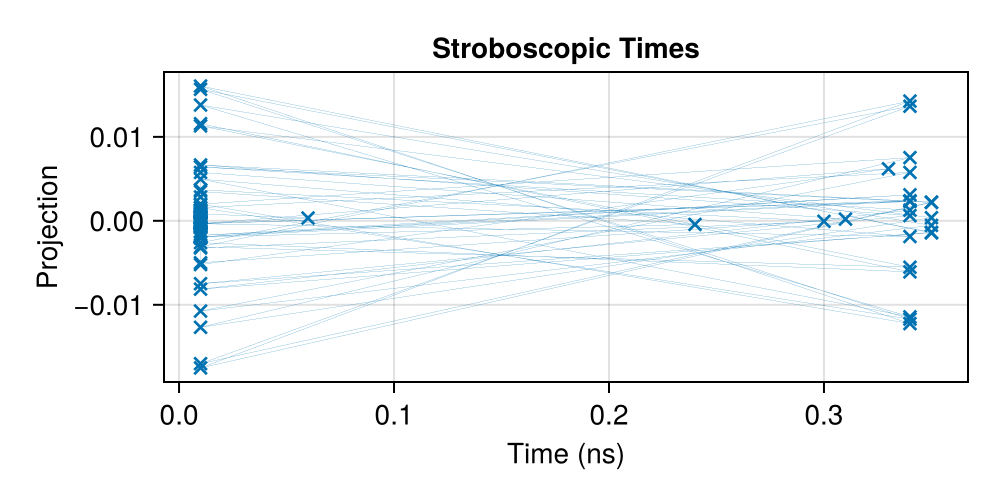

In [296]:
state = string((0,1))
idx = findall(x -> (abs(x-0.5)<1e-2), projections[state])

x = strob_times = times[idx]
y = projections[state][idx]

f = cm.Figure(size = (500, 250))
ax = cm.Axis(f[1,1], title = "Stroboscopic Times", xlabel = "Time (ns)", ylabel = "Projection")

cm.scatterlines!(ax, diff(x), diff(y), marker = '×', label = "Stroboscopic Times", linewidth = 0.1, markersize = 20)
#cm.axislegend(ax, position = :rt)
f

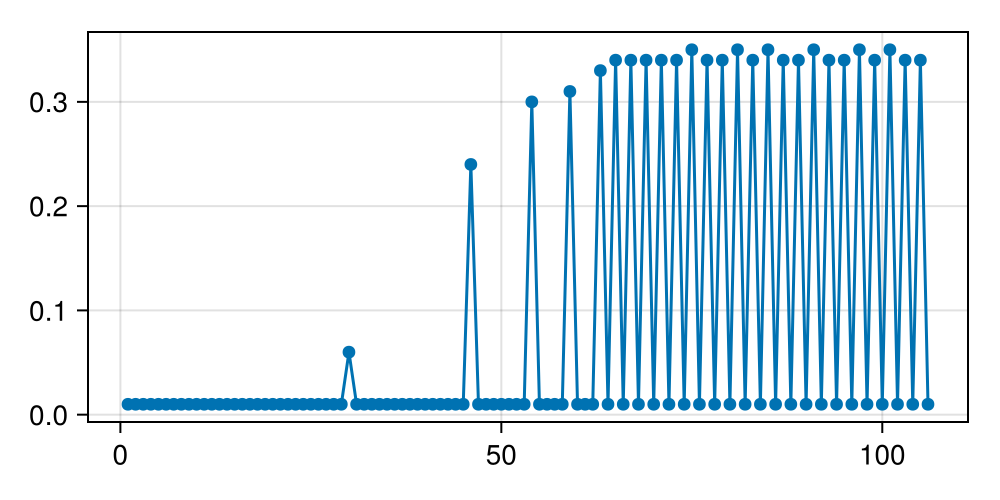

In [39]:
f = cm.Figure(size = (500, 250))
ax = cm.Axis(f[1,1])

cm.scatterlines!(ax, diff(x))

f

In [72]:
for i in 1:length(x)
    println(x[i])
end

0.62
0.63
0.64
0.65
0.66
0.67
0.68
0.69
0.7
0.71
0.72
0.73
0.74
0.75
0.76
0.77
0.78
0.79
0.8
0.81
0.82
0.83
0.84
0.85
0.86
0.87
0.88
0.89
0.9
0.91
0.97
0.98
0.99
1.0
1.01
1.02
1.03
1.04
1.05
1.06
1.07
1.08
1.09
1.1
1.11
1.12
1.36
1.37
1.38
1.39
1.4
1.41
1.42
1.43
1.73
1.74
1.75
1.76
1.77
2.08
2.09
2.1
2.11
2.44
2.45
2.79
2.8
3.14
3.15
3.49
3.5
3.84
3.85
4.19
4.2
4.55
4.56
4.9
4.91
5.25
5.26
5.61
5.62
5.96
5.97
6.32
6.33
6.67
6.68
7.02
7.03
7.38
7.39
7.73
7.74
8.08
8.09
8.44
8.45
8.79
8.8
9.15
9.16
9.5
9.51
9.85
9.86


0.35361709829586846

[2024-10-21 23:41:25] Info: Making Plot


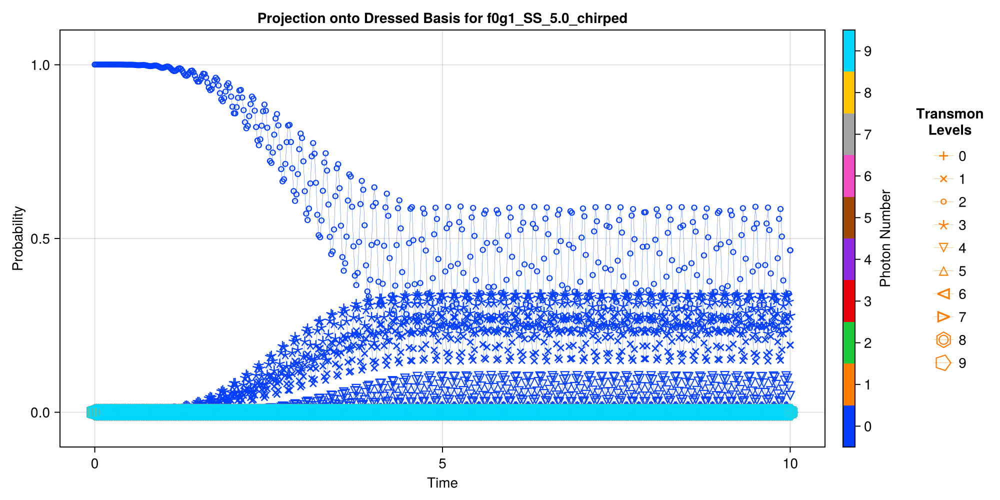

CairoMakie.Screen{IMAGE}


In [90]:
axis_kwargs = Dict{Any, Any}("title" => "Projection onto Dressed Basis for "*op_name)
SC.Dynamics.PlotSingleModeEvolution(Mode3, pulse_res.times, pulse_res.states, axis_kwargs = axis_kwargs)

## No Chirp

In [51]:
Mode3.Stuff["op_drive_params"]["f0g1_SS_6.868999999999999"]

Dict{String, Any} with 7 entries:
  "pulse_time"    => 193.738
  "Envelope Args" => Dict{String, Any}("pulse_time"=>193.738, "ramp_time"=>6.86…
  "epsilon"       => 0.78
  "Envelope"      => "Sine_Squared_Ramp"
  "shift"         => 0.0422004
  "accuracy"      => 0.999859
  "freq_d"        => -2.87015

In [26]:
nc_op_name = "f0g1_SS_6.868999999999999"#"f0g1_SS_70.63291139240506"#
nc_pulse = copy(Mode3.Stuff["op_drive_params"][nc_op_name])

envelope_args = Dict{Symbol, Any}()
for key in keys(Mode3.Stuff["op_drive_params"][nc_op_name]["Envelope Args"])
    envelope_args[Symbol(key)] = Mode3.Stuff["op_drive_params"][nc_op_name]["Envelope Args"][key]
end


εt(t) = ε0*SC.Dynamics.Envelopes.Envelope_Dict[nc_pulse["Envelope"]](t; envelope_args...)
ε0 = nc_pulse["epsilon"]
ν0 = nc_pulse["freq_d"]

νft = ν0+nc_pulse["shift"] 
Tft = abs(1/νft)

#times = vcat(collect(0:Tft:nc_pulse["pulse_time"]), [nc_pulse["pulse_time"]])

pt = nc_pulse["pulse_time"]
rt = nc_pulse["Envelope Args"]["ramp_time"]
ft = pt-2*rt 

Tr = Tft
times = sort(vcat(collect(0:Tr:floor(rt/Tr)*Tr), collect(ceil(rt/Tft)*Tft:10*Tft:floor((ft+rt)/Tft)*Tft), collect(ceil((ft+rt)/Tr)*Tr:Tr:pt), [pt]))

ψ = Mode3.dressed_states[(2,0)]
nc_pulse_res = SC.Dynamics.RunSingleOperator(Mode3, ψ, nc_pulse, spns = 10, tspan = times)



[2024-10-18 18:32:27] Info: Running Time Evolution
Progress: [==============================] 100.0% --- Elapsed Time: 0h 00m 02s (ETA: 0h 00m 00s)
[2024-10-18 18:32:30] Info: Time Evolution Complete
[2024-10-18 18:32:30] Info: Done with DEFAULT


Solution of time evolution
(return code: Success)
--------------------------
num_states = 91
num_expect = 0
ODE alg.: Vern9{typeof(OrdinaryDiffEqCore.trivial_limiter!), typeof(OrdinaryDiffEqCore.trivial_limiter!), Static.False}(OrdinaryDiffEqCore.trivial_limiter!, OrdinaryDiffEqCore.trivial_limiter!, static(false), true)
abstol = 1.0e-6
reltol = 1.0e-6


In [27]:
times = nc_pulse_res.times

nc_epsilons_to_sample = []
for t in times
    ε_temp = εt(t)
    if !(ε_temp in nc_epsilons_to_sample)
        push!(nc_epsilons_to_sample, ε_temp)
    end
end

nc_epsilons_to_sample = sort(nc_epsilons_to_sample) 

nc_Floq_res_list_states = []
nc_Floq_res_list_energies = []

P = Progress(length(nc_epsilons_to_sample))
for ε in nc_epsilons_to_sample
    ν = νft
    T = 1/ν
    drive_coef = SC.Dynamics.Get_Drive_Coef(ν, ε)
    Ĥ_D = SC.Dynamics.Get_Ĥ_D(Mode3.n̂ₜ, drive_coef)
    
    energies, states = SC.Dynamics.Get_Floquet_t0_eigsys(Mode3, Ĥ_D, T)
    push!(nc_Floq_res_list_states, states)
    push!(nc_Floq_res_list_energies, energies)
    next!(P)
end

Progress: 100%|█████████████████████████████████████████| Time: 0:00:23


In [28]:
print(nc_epsilons_to_sample)

Any[0.0, 1.169812630476249e-32, 0.00394973778618241, 0.005089300043169466, 0.017902453891281547, 0.02022437466021938, 0.04156653439368526, 0.045010213923447555, 0.07432437105789357, 0.07879993284397022, 0.11532101793749987, 0.12071165440660327, 0.16348650458771385, 0.16965152565566452, 0.21756376119680051, 0.22434226613545888, 0.27614142681914405, 0.2833565036004233, 0.33769068444869094, 0.3451540269670805, 0.4006051615751267, 0.4081219842439555, 0.46324285485918815, 0.47061697631470173, 0.5239689847360915, 0.5310079479698653, 0.5811986614858116, 0.5877187567753351, 0.6334382492296156, 0.639269308773666, 0.6793243482948891, 0.68431418741865, 0.7176593785485362, 0.7216777675675564, 0.7474428350104297, 0.7503848980918477, 0.7678974000074552, 0.7696863523216957, 0.7784892303677037, 0.7790783820937917, 0.78]

In [29]:
states_to_track = Dict{Any, Any}()
states_to_track[(0,0)] = Mode3.dressed_states[(0,0)]
states_to_track[(1,0)] = Mode3.dressed_states[(1,0)]
states_to_track[(2,0)] = Mode3.dressed_states[(2,0)]
states_to_track[(3,0)] = Mode3.dressed_states[(3,0)]
states_to_track[(4,0)] = Mode3.dressed_states[(4,0)]
states_to_track[(0,1)] = Mode3.dressed_states[(0,1)]
states_to_track[(1,1)] = Mode3.dressed_states[(1,1)]
states_to_track[(2,1)] = Mode3.dressed_states[(2,1)]
states_to_track[(3,1)] = Mode3.dressed_states[(3,1)]
states_to_track[(0,2)] = Mode3.dressed_states[(0,2)]
states_to_track[(1,2)] = Mode3.dressed_states[(1,2)]

nc_Labeled_Floq_States = SC.Utils.State_Tracker(nc_Floq_res_list_states, states_to_track; other_sorts = Dict{Any, Any}("Quasienergies" => nc_Floq_res_list_energies));

[2024-10-18 18:32:54] Info: Tracking State (1, 2)
[2024-10-18 18:32:54] Info: Tracking State (3, 1)
[2024-10-18 18:32:54] Info: Tracking State (0, 2)
[2024-10-18 18:32:54] Info: Tracking State (4, 0)
[2024-10-18 18:32:54] Info: Tracking State (2, 0)
[2024-10-18 18:32:54] Info: Tracking State (2, 1)
[2024-10-18 18:32:54] Info: Tracking State (1, 0)
[2024-10-18 18:32:54] Info: Tracking State (0, 0)
[2024-10-18 18:32:54] Info: Tracking State (1, 1)
[2024-10-18 18:32:54] Info: Tracking State (0, 1)
[2024-10-18 18:32:54] Info: Tracking State (3, 0)


In [30]:
nc_projections = Dict{Any, Any}()


for state in keys(states_to_track)
    nc_projections[state] = []
    for i in 1:length(nc_pulse_res.times)
        t = nc_pulse_res.times[i]
        idx = findall(x -> x==εt(t), nc_epsilons_to_sample)
        Φ = nc_Labeled_Floq_States[State = At(string(state)), Step = At(idx[1])]["ψ"]
        push!(nc_projections[state], abs(nc_pulse_res.states[i]'*Φ)^2)
    end
end

[2024-10-18 18:32:54] Info: Making Plot


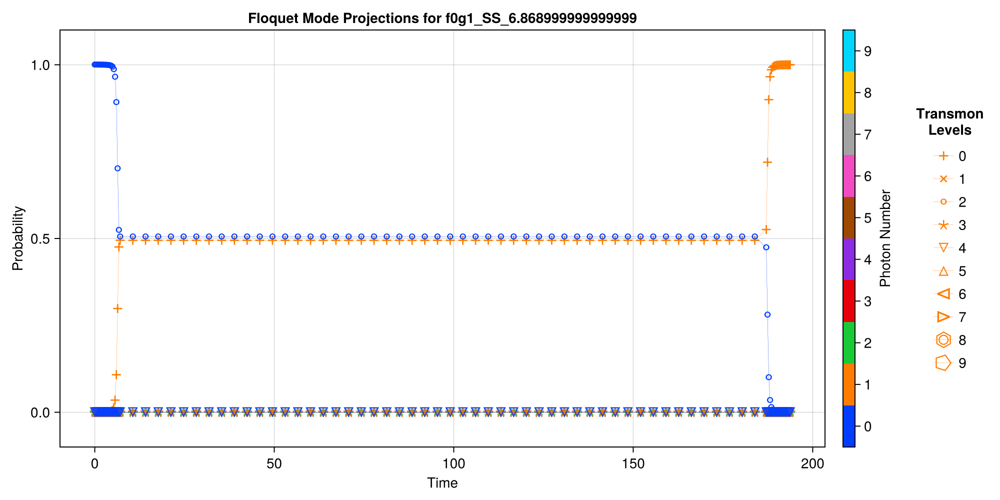

CairoMakie.Screen{IMAGE}


In [31]:
axis_kwargs = Dict{Any, Any}("title" => "Floquet Mode Projections for "*nc_op_name)
SC.Dynamics.PlotSingleModeEvolution(Mode3, nc_pulse_res.times, nc_projections, axis_kwargs = axis_kwargs)

[2024-10-18 18:32:54] Info: Making Plot


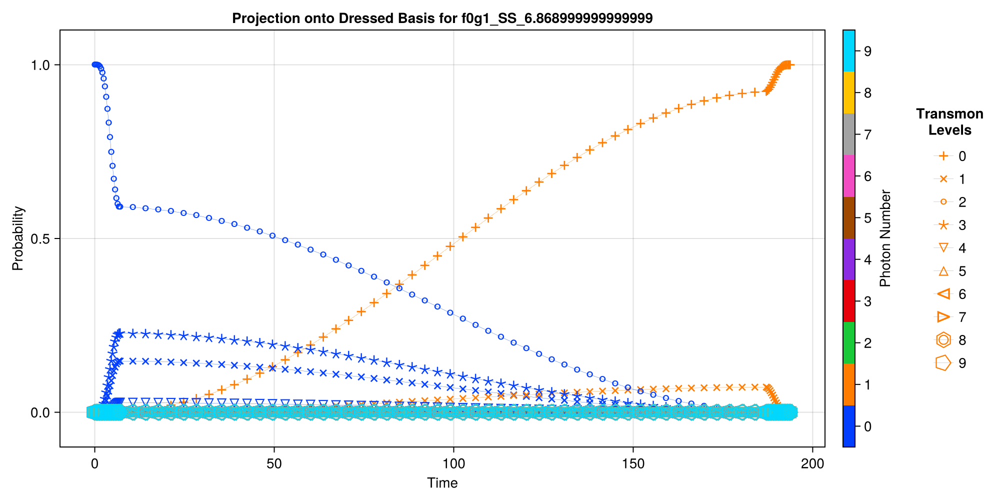

CairoMakie.Screen{IMAGE}


In [32]:
axis_kwargs = Dict{Any, Any}("title" => "Projection onto Dressed Basis for "*nc_op_name)
SC.Dynamics.PlotSingleModeEvolution(Mode3, nc_pulse_res.times, nc_pulse_res.states, axis_kwargs = axis_kwargs, plot_every = 1)

In [201]:
abs(nc_pulse_res.states[end]'*Mode3.dressed_states[(0,1)])^2

0.9998576305161789

# Playing with propagtors

In [59]:
H = Mode3.Ĥ
T = abs(1/νft)
drive_coef = SC.Dynamics.Get_Drive_Coef(νft, ε0)
Ĥ_D = SC.Dynamics.Get_Ĥ_D(Mode3.n̂ₜ, drive_coef, TDOS = false)

function func(u, p, t)
    return -1im*(2*π*H.data-Ĥ_D(t).data)*u
end

u0 = Matrix(qt.qeye(prod(H.dims), dims = H.dims).data)

tspan = [0.0, T]

prob = ODEProblem(func, u0, tspan)

U = solve(prob, Vern9())#, reltol = 1e-9, abstol= 1e-9)

retcode: Success
Interpolation: specialized 9th order lazy interpolation
t: 82-element Vector{Float64}:
 0.0
 0.00043429488240878943
 0.002168826165068345
 0.004750202419891966
 0.007716564775305905
 0.010950153979857704
 0.014438502927480158
 0.018127948646661615
 0.022004277244141602
 0.026033599084528604
 ⋮
 0.31912004198047556
 0.32370807048950173
 0.32829335544868476
 0.3329223392946296
 0.33755492268635695
 0.34220501484643173
 0.34685398302693543
 0.3514973787614672
 0.35361709829586846
u: 82-element Vector{Matrix{ComplexF64}}:
 [1.0 + 0.0im 0.0 + 0.0im … 0.0 + 0.0im 0.0 + 0.0im; 0.0 + 0.0im 1.0 + 0.0im … 0.0 + 0.0im 0.0 + 0.0im; … ; 0.0 + 0.0im 0.0 + 0.0im … 1.0 + 0.0im 0.0 + 0.0im; 0.0 + 0.0im 0.0 + 0.0im … 0.0 + 0.0im 1.0 + 0.0im]
 [0.9977403582621308 + 0.06718752128449554im -1.6400587613926184e-9 - 8.955459814791263e-11im … 2.423372309729076e-37 + 3.629029997436175e-36im 6.887484280467712e-37 + 1.0483115051214214e-35im; -1.6400354007164607e-9 - 8.955334718779406e-11im 0.9987

In [7]:
H = Mode3.Ĥ
drive_coef = SC.Dynamics.Get_Drive_Coef(νft, ε0)
Ĥ_D_TDOS = SC.Dynamics.Get_Ĥ_D(Mode3.n̂ₜ, drive_coef)
U2 = SC.Dynamics.Propagator(Mode3, Ĥ_D_TDOS, T)

Quantum Object:   type=Operator   dims=[10, 10]   size=(100, 100)   ishermitian=false
100×100 Matrix{ComplexF64}:
     0.406915-0.774027im     …  -1.58183e-18-8.62134e-20im
    -0.012058+0.00329622im      -4.77092e-17+5.56821e-18im
 -0.000115513+0.000119068im     -1.62732e-14-1.69865e-15im
    4.2102e-6+2.49405e-6im       1.44282e-13-8.93034e-13im
    5.0023e-8-2.84158e-8im       4.20141e-11+3.59634e-11im
 -3.43312e-10-1.6765e-9im    …   -1.42648e-9+2.26057e-9im
 -2.39439e-11-3.09236e-12im       -6.6346e-8-1.72598e-8im
 -3.49239e-13+4.47803e-13im      -4.19164e-8-1.08819e-6im
  4.91355e-15+7.69246e-15im       1.01197e-5-3.62636e-6im
  1.81681e-16+1.08604e-18im       3.25176e-5+3.94502e-5im
             ⋮               ⋱  
  -3.22448e-6-1.41662e-6im       2.98728e-12-4.38139e-13im
  -9.29895e-8-1.53464e-7im        1.1354e-10-3.32114e-10im
  3.40494e-10-7.42172e-9im       -1.57169e-8-1.46342e-8im
  1.42695e-10-1.89171e-10im      -6.56061e-7+2.54941e-7im
  4.32146e-12-2.30113e-12im  …    

In [8]:
floq_SC = SC.Dynamics.Get_Floquet_t0_Eigsys(Mode3, Ĥ_D_TDOS, T);

In [9]:
sort(floq_SC[1])

100-element Vector{Float64}:
 -8.67241502631952
 -8.458767884631616
 -8.34530541830045
 -8.1193929225114
 -7.500164349192065
 -7.353343915576162
 -7.329523513937157
 -7.309206624538774
 -7.12942699447419
 -7.083219602666031
  ⋮
  7.300565437505187
  7.350921436368923
  7.391331376303637
  7.5358947817944415
  7.611093338156884
  8.417376349563755
  8.636030712240805
  8.65650658230234
  8.80782795178909

In [17]:
U_eigs = eigen(U(T))

sort(-angle.(U_eigs.values)/T)

100-element Vector{Float64}:
 -8.672415041125623
 -8.458767899512685
 -8.345305419170044
 -8.119392926852726
 -7.50016435610363
 -7.353343913060461
 -7.329523511955546
 -7.309206568239677
 -7.129426997896724
 -7.083219605277857
  ⋮
  7.300565437492996
  7.35092147449824
  7.391331378455216
  7.5358947774944935
  7.611093327325577
  8.417376332966747
  8.636030702259198
  8.656506615326519
  8.807828009390033

[2024-10-21 11:13:19] Warn: To maintain consistency with solution indexing, keyword argument vars will be removed in a future version. Please use keyword argument idxs instead. caller = ip:0x0


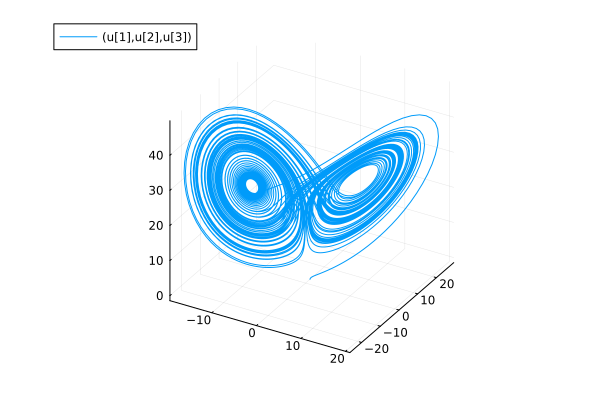

In [12]:
function lorenz!(du,u,p,t)
    du[1] = 10.0(u[2]-u[1])
    du[2] = u[1]*(28.0-u[3]) - u[2]
    du[3] = u[1]*u[2] - (8/3)*u[3]
   end
   u0 = [1.0;0.0;0.0]
   tspan = (0.0,100.0)
   prob = ODEProblem(lorenz!,u0,tspan)
   
   
   sol = solve(prob,Tsit5())
   using Plots; plot(sol,vars=(1,2,3))